# Analiza obrazu - detekcja twarzy

In [143]:
import cv2
from google.colab.patches import cv2_imshow
from skimage import io
import dlib
import datetime

## Inicjalizacja - pobranie obrazu testowego i modeli dla detektorów twarzy

In [144]:
# https://drive.google.com/file/d/1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ/view?usp=sharing
!gdown --id 1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ
To: /content/2_Demonstration_Demonstration_Or_Protest_2_1.jpg
100% 147k/147k [00:00<00:00, 101MB/s]


In [145]:
# https://drive.google.com/file/d/1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul/view?usp=sharing
!gdown --id 1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul
To: /content/haarcascade_frontalface_default.xml
100% 930k/930k [00:00<00:00, 116MB/s]


In [146]:
# https://drive.google.com/file/d/1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_/view?usp=sharing
!gdown --id 1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_
To: /content/mmod_human_face_detector.dat
100% 730k/730k [00:00<00:00, 108MB/s]


## Pobranie dodatkowych obrazów

In [147]:
# https://drive.google.com/file/d/1x7lQkoptBBJPURP7ihQ21gMB84ANjfMT/view?usp=sharing
!gdown --id 1x7lQkoptBBJPURP7ihQ21gMB84ANjfMT

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1x7lQkoptBBJPURP7ihQ21gMB84ANjfMT
To: /content/8_people.jpg
100% 462k/462k [00:00<00:00, 136MB/s]


In [148]:
# https://drive.google.com/file/d/1rRpnEKDo5xF3qSiNLgls2rHN4Yrqs7xl/view?usp=sharing
!gdown --id 1rRpnEKDo5xF3qSiNLgls2rHN4Yrqs7xl

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1rRpnEKDo5xF3qSiNLgls2rHN4Yrqs7xl
To: /content/10_people.jpg
100% 468k/468k [00:00<00:00, 144MB/s]


In [149]:
# https://drive.google.com/file/d/14K3tdmv_S7USo3wvnLeGL5wVK4kvK5BE/view?usp=sharing
!gdown --id 14K3tdmv_S7USo3wvnLeGL5wVK4kvK5BE

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=14K3tdmv_S7USo3wvnLeGL5wVK4kvK5BE
To: /content/56_Voter_peoplevoting_56_106.jpg
100% 102k/102k [00:00<00:00, 75.9MB/s]


##Weryfikacja pobranych danych

In [150]:
# 70c923864f4bdb5ae08b3061a9667781  8_people.jpg
!md5sum 8_people.jpg

70c923864f4bdb5ae08b3061a9667781  8_people.jpg


In [151]:
# 3d821d7b9864a6792192d1c03f389f70  10_people.jpg
!md5sum 10_people.jpg

3d821d7b9864a6792192d1c03f389f70  10_people.jpg


In [152]:
# d254e42fc91edf59e2553562afca256d  56_Voter_peoplevoting_56_106.jpg
!md5sum 56_Voter_peoplevoting_56_106.jpg

d254e42fc91edf59e2553562afca256d  56_Voter_peoplevoting_56_106.jpg


## Obraz testowy

Name:  Demonstration


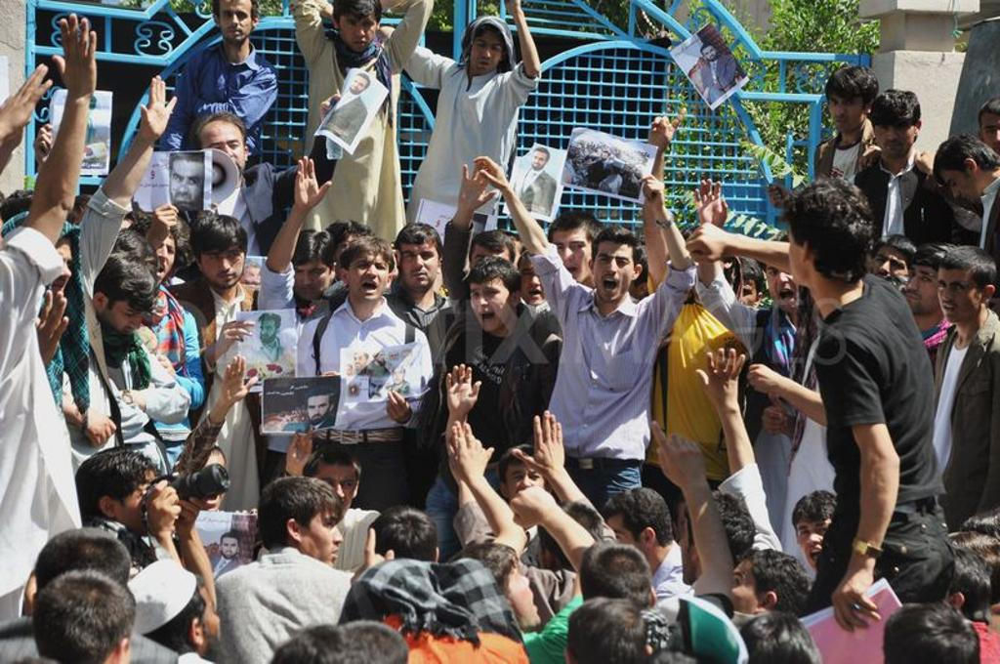

In [153]:
print("Name: ", 'Demonstration')
img = cv2.imread("2_Demonstration_Demonstration_Or_Protest_2_1.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2_imshow(img)

##Dodatkowe obrazy testowe

Name:  wedding


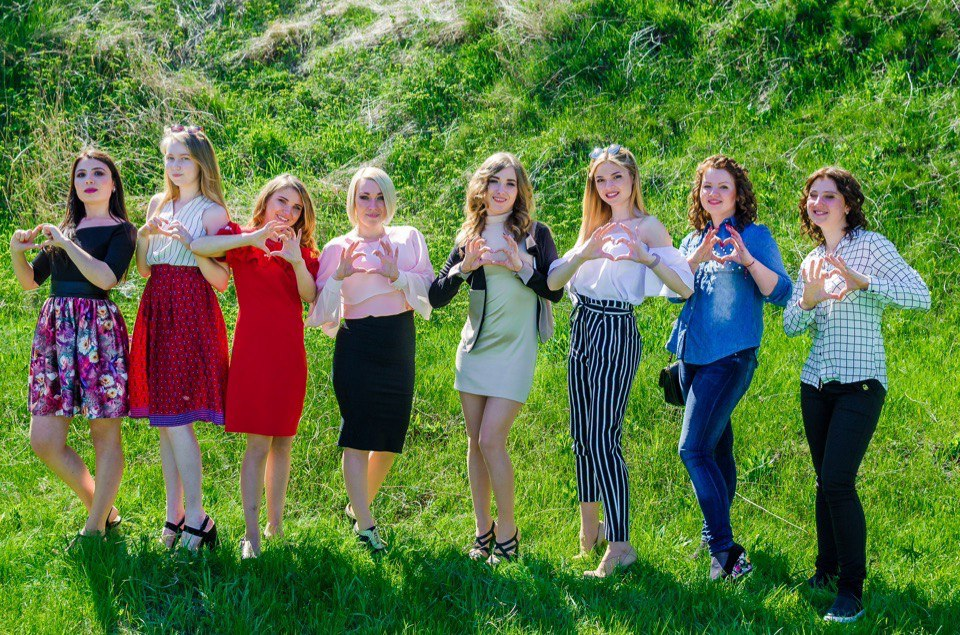

In [154]:
print("Name: ", 'wedding')
easy_img = cv2.imread("8_people.jpg")
easy_gray = cv2.cvtColor(easy_img, cv2.COLOR_BGR2GRAY)
easy_rgb = cv2.cvtColor(easy_img, cv2.COLOR_BGR2RGB)

cv2_imshow(easy_img)

Name:  school


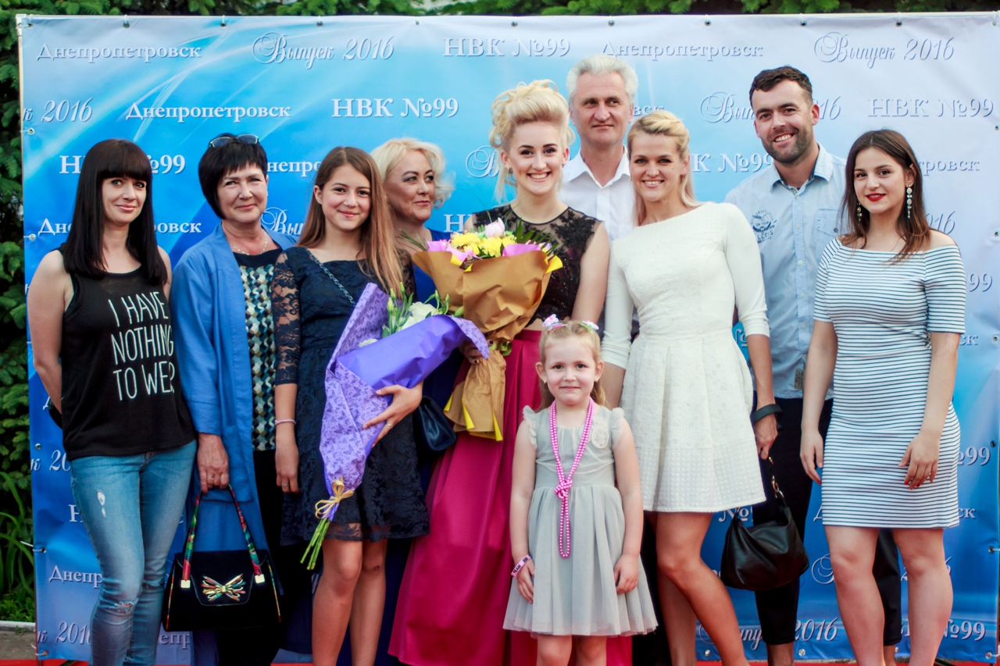

In [155]:
print("Name: ", 'school')
easy1_img = cv2.imread("10_people.jpg")
easy1_gray = cv2.cvtColor(easy1_img, cv2.COLOR_BGR2GRAY)
easy1_rgb = cv2.cvtColor(easy1_img, cv2.COLOR_BGR2RGB)

cv2_imshow(easy1_img)

Name:  India


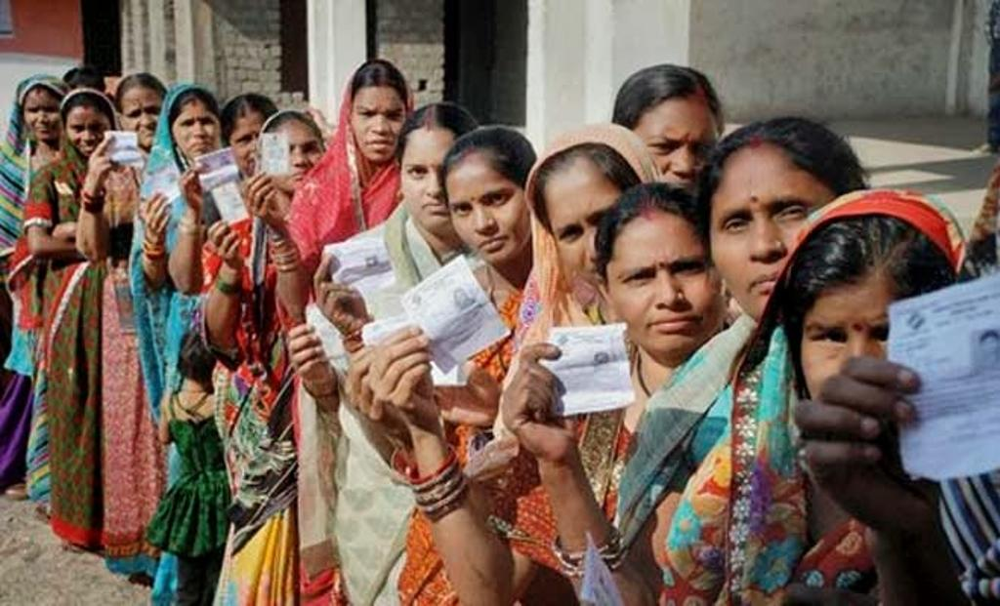

In [156]:
print("Name: ", 'India')
hard_img = cv2.imread("56_Voter_peoplevoting_56_106.jpg")
hard_gray = cv2.cvtColor(hard_img, cv2.COLOR_BGR2GRAY)
hard_rgb = cv2.cvtColor(hard_img, cv2.COLOR_BGR2RGB)

cv2_imshow(hard_img)

##Czas algorytmów

In [192]:
times = {
    'haar_Demonstration': None,
    'haar_Wedding': None,
    'haar_School': None,
    'haar_India': None,
    'hog_Demonstration': None,
    'hog_Wedding': None,
    'hog_School': None,
    'hog_India': None,
    'mmod_Demonstration': None,
    'mmod_Wedding': None,
    'mmod_School': None,
    'mmod_India': None,
}

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [195]:
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

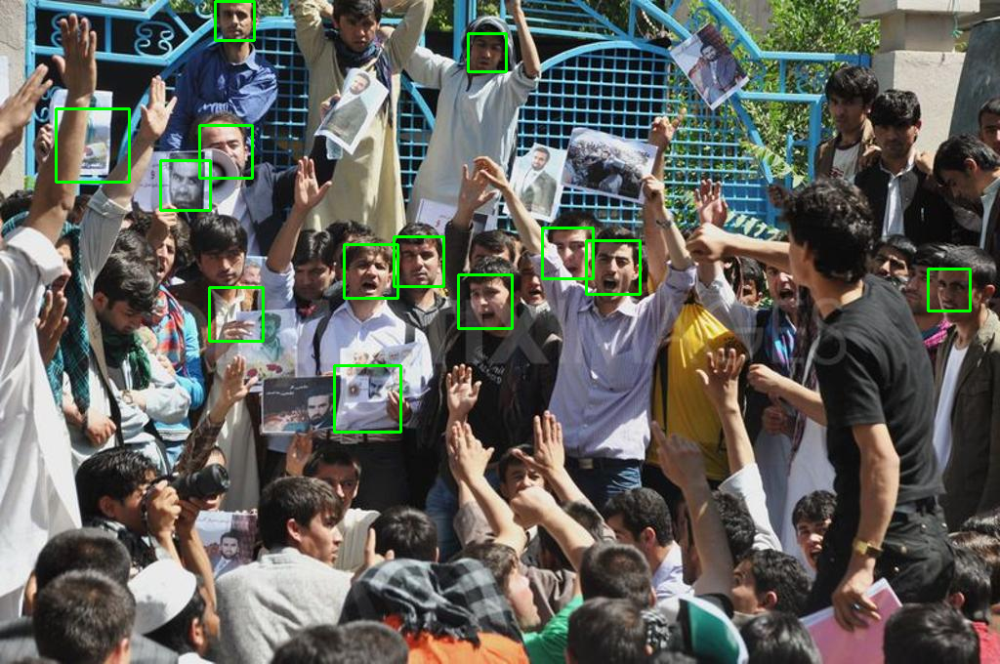

In [196]:
time_start = datetime.datetime.now()
rects = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

img_haar = img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(img_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['haar_Demonstration'] = time_stop - time_start
cv2_imshow(img_haar)


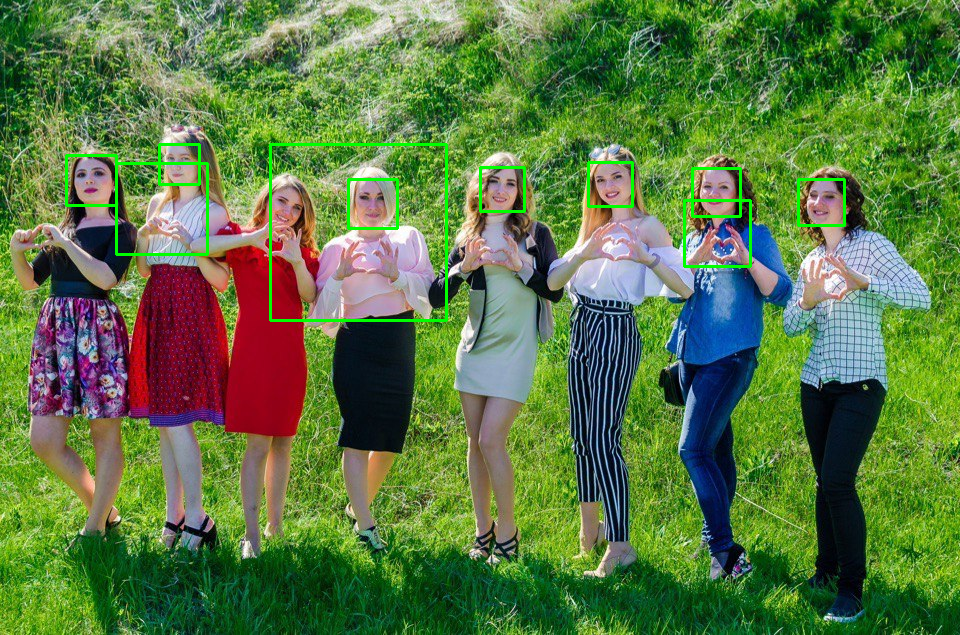

In [197]:
time_start = datetime.datetime.now()
rects = haar_detector.detectMultiScale(easy_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

easy_haar = easy_img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(easy_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['haar_Wedding'] = time_stop - time_start
cv2_imshow(easy_haar)

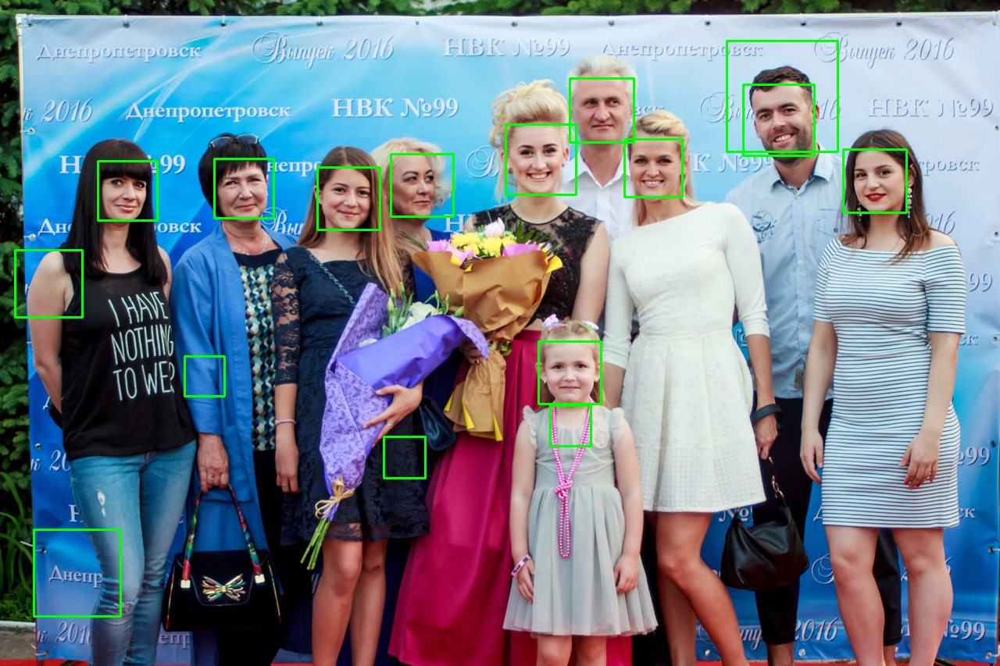

In [198]:
time_start = datetime.datetime.now()
rects = haar_detector.detectMultiScale(easy1_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

easy1_haar = easy1_img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(easy1_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['haar_School'] = time_stop - time_start
cv2_imshow(easy1_haar)

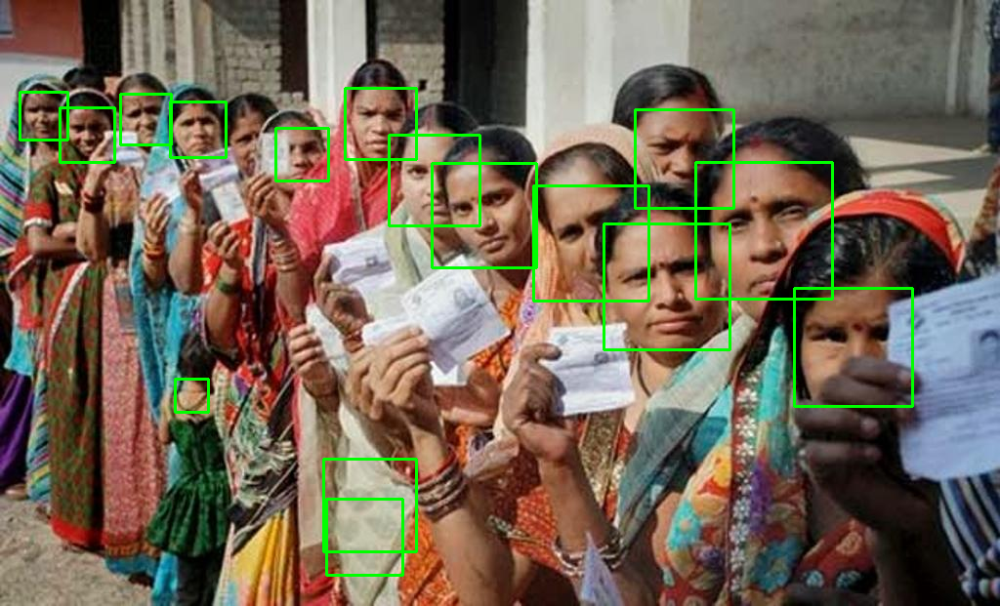

In [199]:
time_start = datetime.datetime.now()
rects = haar_detector.detectMultiScale(hard_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

hard_haar = hard_img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(hard_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['haar_India'] = time_stop - time_start
cv2_imshow(hard_haar)

## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [200]:
def convert_and_trim_bb(image, rect):
	# extract the starting and ending (x, y)-coordinates of the
	# bounding box
	startX = rect.left()
	startY = rect.top()
	endX = rect.right()
	endY = rect.bottom()
	# ensure the bounding box coordinates fall within the spatial
	# dimensions of the image
	startX = max(0, startX)
	startY = max(0, startY)
	endX = min(endX, image.shape[1])
	endY = min(endY, image.shape[0])
	# compute the width and height of the bounding box
	w = endX - startX
	h = endY - startY
	# return our bounding box coordinates
	return (startX, startY, w, h)

In [201]:
hog_svm_detector = dlib.get_frontal_face_detector()

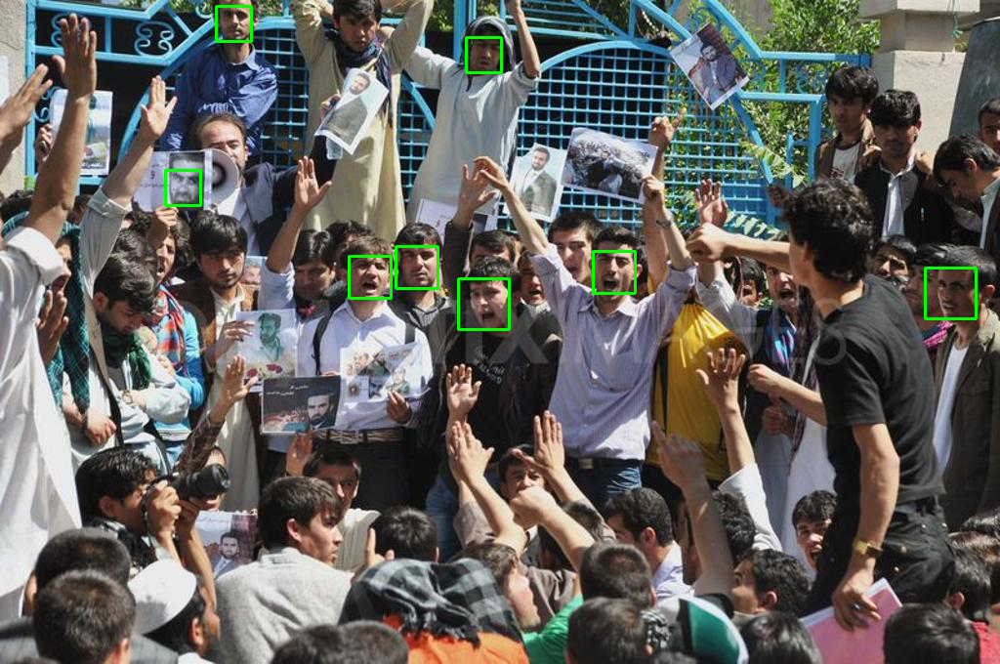

In [202]:
hog_svm_rects = hog_svm_detector(img_rgb, 1)

time_start = datetime.datetime.now()
hog_svm_boxes = [convert_and_trim_bb(img, r) for r in hog_svm_rects]

img_hog_svm = img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(img_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2) 
time_stop = datetime.datetime.now()
times['hog_Demonstration'] = time_stop - time_start 
cv2_imshow(img_hog_svm)

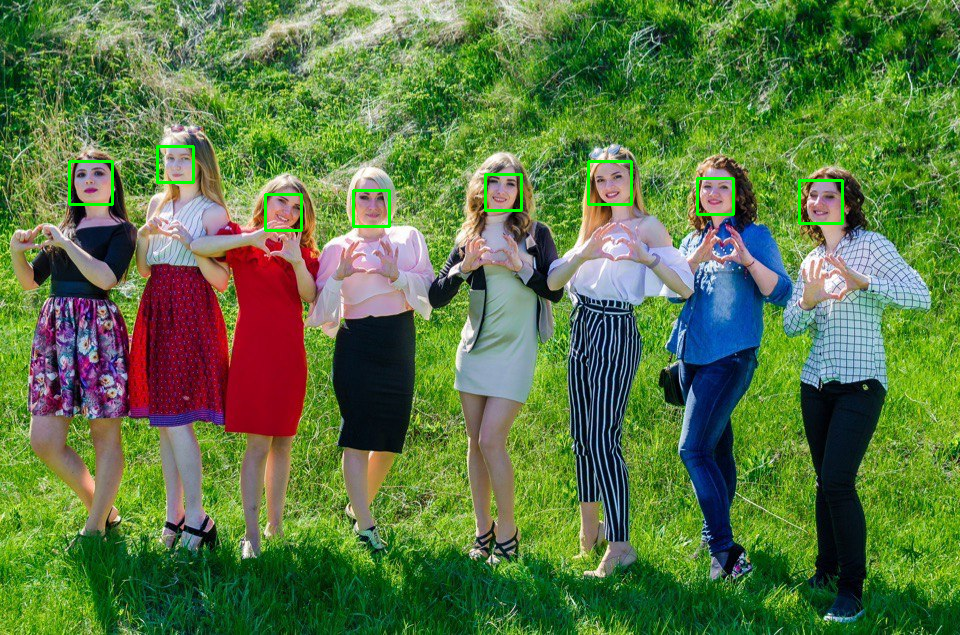

In [203]:
hog_svm_rects = hog_svm_detector(easy_rgb, 1)

time_start = datetime.datetime.now()
hog_svm_boxes = [convert_and_trim_bb(easy_img, r) for r in hog_svm_rects]

easy_hog_svm = easy_img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(easy_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['hog_Wedding'] = time_stop - time_start 
cv2_imshow(easy_hog_svm)

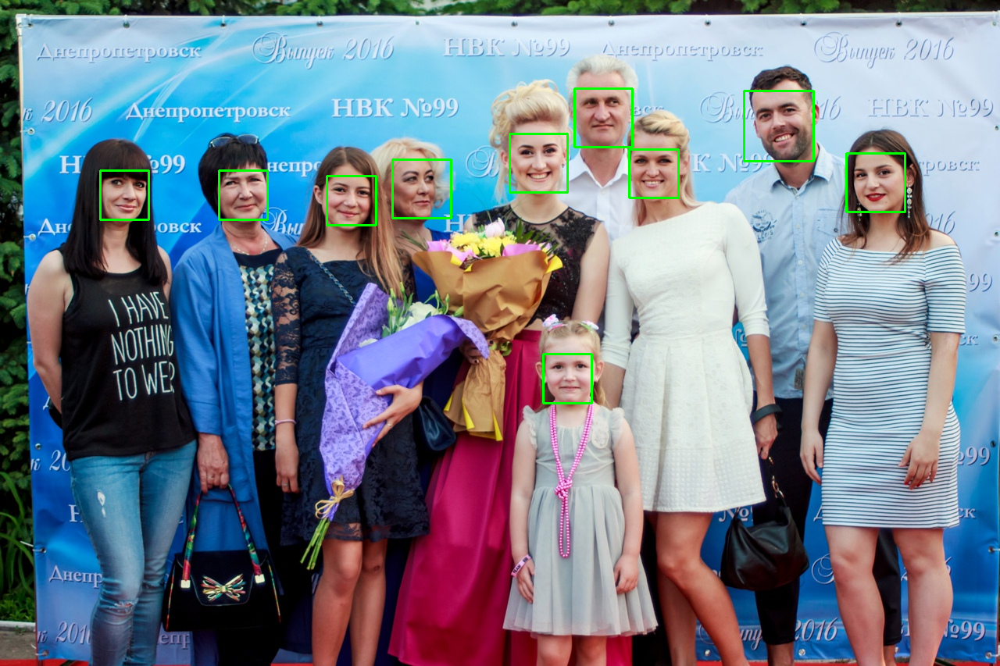

In [204]:
hog_svm_rects = hog_svm_detector(easy1_rgb, 1)

time_start = datetime.datetime.now()
hog_svm_boxes = [convert_and_trim_bb(easy1_img, r) for r in hog_svm_rects]

easy1_hog_svm = easy1_img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(easy1_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['hog_School'] = time_stop - time_start 
cv2_imshow(easy1_hog_svm)

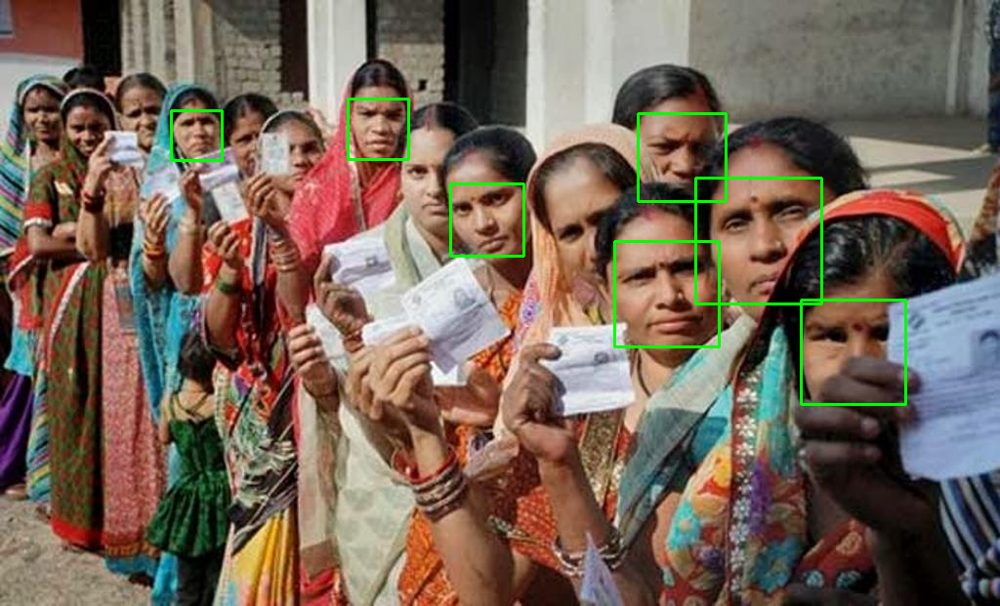

In [205]:
hog_svm_rects = hog_svm_detector(hard_rgb, 1)

time_start = datetime.datetime.now()
hog_svm_boxes = [convert_and_trim_bb(hard_img, r) for r in hog_svm_rects]

hard_hog_svm = hard_img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(hard_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['hog_India'] = time_stop - time_start  
cv2_imshow(hard_hog_svm)

## Splotowa sieć neuronowa (CNN)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [206]:
cnn_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

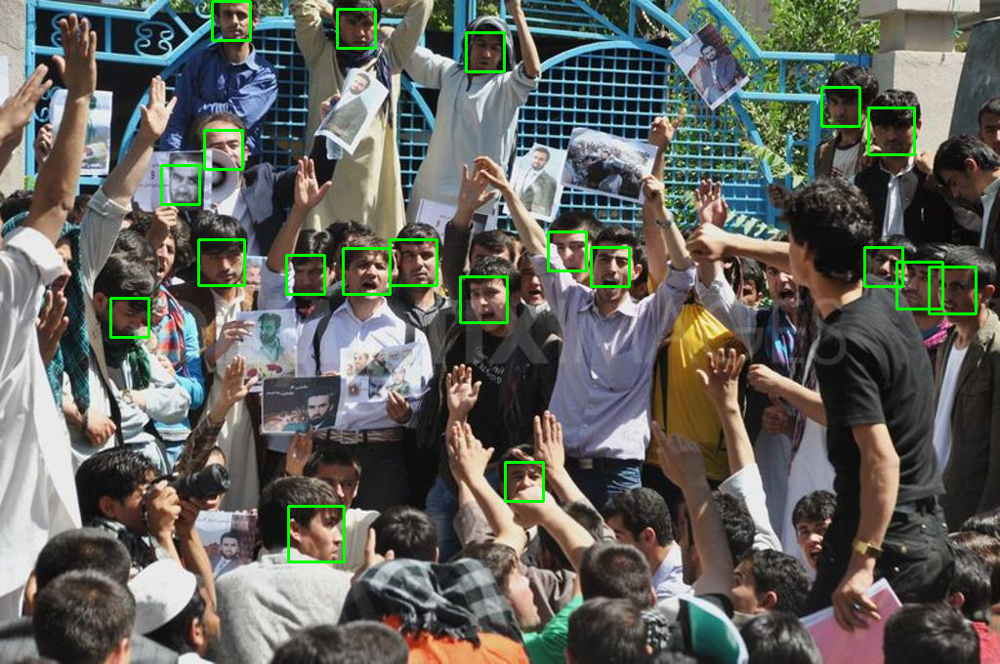

In [207]:
cnn_rects = cnn_detector(img_rgb, 1)

time_start = datetime.datetime.now()

cnn_boxes = [convert_and_trim_bb(img, r.rect) for r in cnn_rects]

img_cnn = img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(img_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['mmod_Demonstration'] = time_stop - time_start
 
cv2_imshow(img_cnn)

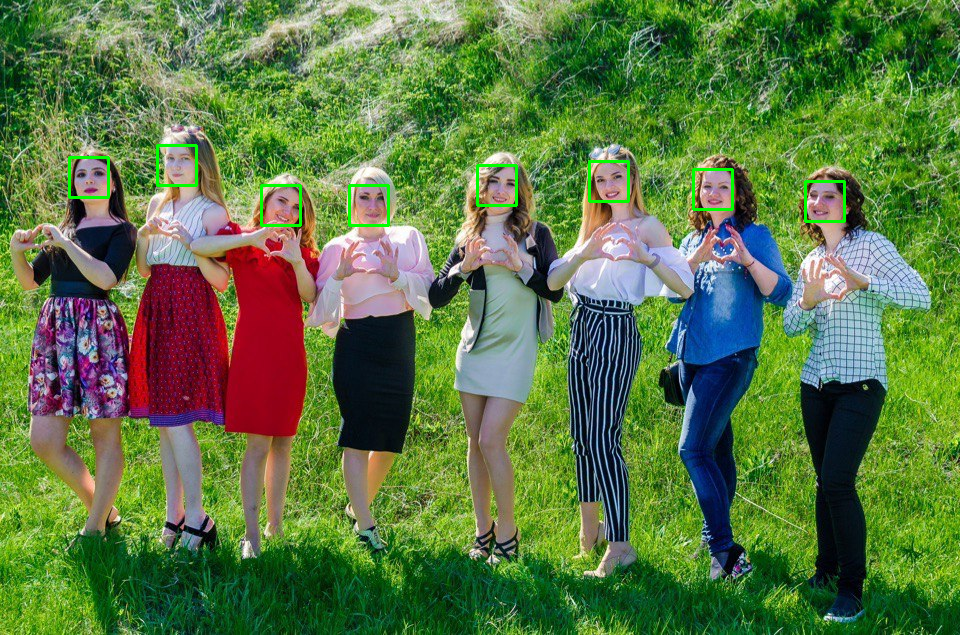

In [208]:
cnn_rects = cnn_detector(easy_rgb, 1)
time_start = datetime.datetime.now()

cnn_boxes = [convert_and_trim_bb(easy_img, r.rect) for r in cnn_rects]

easy_cnn = easy_img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(easy_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['mmod_Wedding'] = time_stop - time_start 
cv2_imshow(easy_cnn)

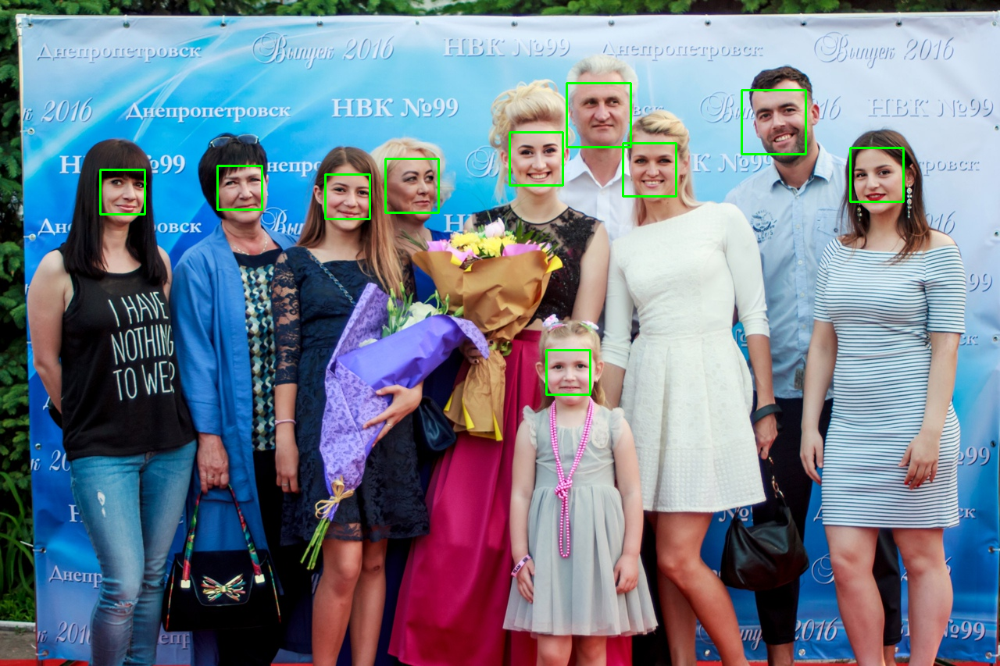

In [209]:
cnn_rects = cnn_detector(easy1_rgb, 1)
time_start = datetime.datetime.now()

cnn_boxes = [convert_and_trim_bb(easy1_img, r.rect) for r in cnn_rects]

easy1_cnn = easy1_img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(easy1_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['mmod_School'] = time_stop - time_start 
cv2_imshow(easy1_cnn)

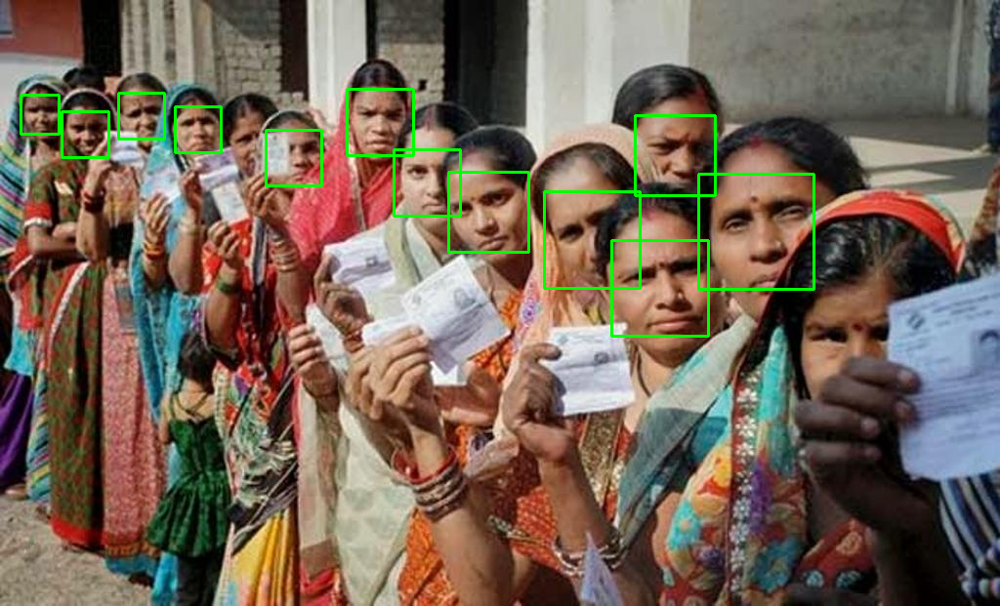

In [210]:
cnn_rects = cnn_detector(hard_rgb, 1)
time_start = datetime.datetime.now()
cnn_boxes = [convert_and_trim_bb(hard_img, r.rect) for r in cnn_rects]

hard_cnn = hard_img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(hard_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
time_stop = datetime.datetime.now()
times['mmod_India'] = time_stop - time_start  
cv2_imshow(hard_cnn)

##Czas wykonania algorytmów

In [211]:
print(times)

{'haar_Demonstration': datetime.timedelta(seconds=1, microseconds=4465), 'haar_Wedding': datetime.timedelta(seconds=1, microseconds=46504), 'haar_School': datetime.timedelta(seconds=1, microseconds=420987), 'haar_India': datetime.timedelta(seconds=1, microseconds=16044), 'hog_Demonstration': datetime.timedelta(microseconds=1234), 'hog_Wedding': datetime.timedelta(microseconds=1145), 'hog_School': datetime.timedelta(microseconds=1616), 'hog_India': datetime.timedelta(microseconds=1224), 'mmod_Demonstration': datetime.timedelta(microseconds=1586), 'mmod_Wedding': datetime.timedelta(microseconds=1115), 'mmod_School': datetime.timedelta(microseconds=3424), 'mmod_India': datetime.timedelta(microseconds=2227)}
